In [1]:
import tensorflow as tf
import keras
from keras.models import Sequential
from keras.layers import Dense
from keras.utils import np_utils
from keras import regularizers
import numpy as np
from sklearn.metrics import accuracy_score
from sklearn import preprocessing
from sklearn.preprocessing import QuantileTransformer
import os.path
from netCDF4 import Dataset
import matplotlib.pyplot as plt
from cartopy import config
import cartopy.crs as ccrs
import pandas as pd
import seaborn as sns
from sklearn.metrics import r2_score
import scipy.stats
data_dir = "./Monthly/"

monthsArr=['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']

<class 'netCDF4._netCDF4.Dataset'>
root group (NETCDF4 data model, file format HDF5):
    dimensions(sizes): x(2613), time(108)
    variables(dimensions): int64 x(x), int64 time(time), float64 monthly_flux(time, x), float64 se_monthly_flux(time, x)
    groups: 
(282204, 1)
(12, 9, 1)


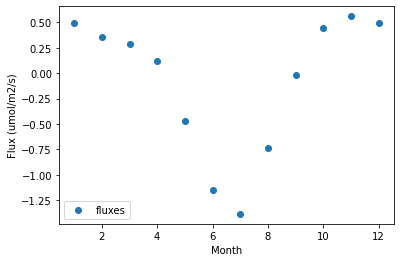

In [2]:
filename_flux = data_dir + "flux_training/geoinv-sif-monthly-2007-to-2015.nc"
nc_inv = Dataset(filename_flux, 'r')  # open inversion file using netcdf reader
print(nc_inv)
flux_var = np.array(nc_inv.variables['monthly_flux']) # create numpy array note shape of flux is [ time dimension x space dimension]

num_rows, num_cols = flux_var.shape # number of rows and columns

flux_var=flux_var.reshape((num_rows*num_cols, 1),) # reshape into one vector by stacking each column (month)

# double check shape/reshape order

# plot monthly average
print(flux_var.shape)

# reshape to average by month
b = np.reshape(np.ravel(flux_var, order='F'), (2613,12,9,-1),order='F')
# average by year
b = np.mean(b,axis=0)

print(b.shape)
# average by month
b = np.mean(b,axis=1)

# print(X_full_av_mon.shape)

# month variable
mon_array = np.arange(1, 13, dtype=float)

# plot monthly averages averaged over all North America
plt.scatter(mon_array,b,label="fluxes")
plt.legend(loc="lower left")

plt.xlabel('Month')
plt.ylabel('Flux (umol/m2/s)')
plt.show()

In [3]:
# load lat lon variables and create month variable
filename_narr = data_dir + "predictors/narr-2007-NA-monthly.nc"
nc_narr = Dataset(filename_narr, 'r')  # open data file using netcdf reader
lat_var = np.array(nc_narr.variables["lat"]) # create numpy array note shape of lat vars is [space dimension ]
lon_var = np.array(nc_narr.variables["lon"]) # create numpy array note shape of lat vars is [space dimension ]

# tile to correct dimensions
lat_var_all=np.tile(lat_var,(1,12*9))
lon_var_all=np.tile(lon_var,(1,12*9))

# creat lat and lon variables
lat_var_all=np.transpose(lat_var_all)
lon_var_all=np.transpose(lon_var_all)

print(lon_var_all.shape)
print(lat_var_all.shape)

# create month variable
month_vec=[]
for months in range(1, 13):
    a=np.empty(2613);
    a.fill(months)
    month_vec.extend(a)

month_vec=np.tile(month_vec,(1,9))
month_vec=np.transpose(month_vec)
print(month_vec.shape)



# double check shape/reshape order

# plot monthly average
print(flux_var.shape)

# reshape to average by month
b = np.reshape(np.ravel(month_vec, order='F'), (2613,12,9,-1),order='F')
# average by year
b = np.mean(b,axis=0)

print(b.shape)
# average by month
b = np.mean(b,axis=1)

# print(X_full_av_mon.shape)

# month variable
mon_array = np.arange(1, 13, dtype=float)

(282204, 1)
(282204, 1)
(282204, 1)
(282204, 1)
(12, 9, 1)


In [4]:
filename_modis = data_dir + "predictors/modis-2007-to-2016-NA-monthly.nc"
nc_modis = Dataset(filename_modis, 'r')  # open data file using netcdf reader
nirv_var = np.array(nc_modis.variables["NIRv"]) # create numpy array note shape of narr vars is [space dimension x time dimension]
num_rows, num_cols = nirv_var.shape # number of rows and columns\

nirv_var=nirv_var.reshape((num_rows*num_cols, 1),order='F') # reshape into one vector by stacking each column (month)
nirv_var=nirv_var[0:2613*9*12]
nirv_var[np.isnan(nirv_var)] = 0
print(nirv_var.shape)

ndvi_var = np.array(nc_modis.variables["NDVI"])
ndvi_var=ndvi_var.reshape((num_rows*num_cols, 1))
ndvi_var=ndvi_var[0:2613*9*12]
ndvi_var[np.isnan(ndvi_var)] = 0
print(ndvi_var.shape)


(282204, 1)
(282204, 1)


In [5]:
# filename for sif data
filename_sif = data_dir + "predictors/sif-2007-to-2016-NA-monthly.nc"
nc_sif = Dataset(filename_sif, 'r')

sif_varR = np.array(nc_sif.variables["RSIF::SIF"]) # create numpy array note shape of narr vars is [space dimension x time dimension]
num_rows, num_cols = sif_varR.shape # number of rows and columns
sif_varR=sif_varR.reshape((num_rows*num_cols, 1),order='F') # reshape into one vector by stacking each column (month)
sif_varR=sif_varR[0:2613*9*12]
sif_varR[np.isnan(sif_varR)] = 0
print(sif_varR.shape)

sif_var2A = np.array(nc_sif.variables["GOME2A::SIF"]) # create numpy array note shape of narr vars is [space dimension x time dimension]
num_rows, num_cols = sif_var2A.shape # number of rows and columns
sif_var2A=sif_var2A.reshape((num_rows*num_cols, 1),order='F') # reshape into one vector by stacking each column (month)
sif_var2A=sif_var2A[0:2613*9*12]
sif_var2A[np.isnan(sif_var2A)] = 0
print(sif_var2A.shape)

sif_var2B = np.array(nc_sif.variables["GOME2B::SIF"]) # create numpy array note shape of narr vars is [space dimension x time dimension]
num_rows, num_cols = sif_var2B.shape # number of rows and columns
sif_var2B=sif_var2B.reshape((num_rows*num_cols, 1),order='F') # reshape into one vector by stacking each column (month)
sif_var2B=sif_var2B[0:2613*9*12]
sif_var2B[np.isnan(sif_var2B)] = 0
print(sif_var2B.shape)

sif_var_oco2 = np.array(nc_sif.variables["OCO2::SIF"]) # create numpy array note shape of narr vars is [space dimension x time dimension]
num_rows, num_cols = sif_var_oco2.shape # number of rows and columns
sif_var_oco2=sif_var_oco2.reshape((num_rows*num_cols, 1),order='F') # reshape into one vector by stacking each column (month)
sif_var_oco2=sif_var_oco2[0:2613*9*12]
sif_var_oco2[np.isnan(sif_var_oco2)] = 0
print(sif_var_oco2.shape)

(282204, 1)
(282204, 1)
(282204, 1)
(282204, 1)


(12, 9, 1)


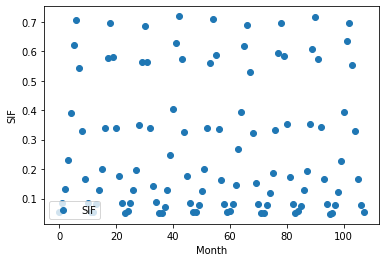

In [6]:
b = np.reshape(np.ravel(sif_varR, order='F'), (2613,12,9,-1),order='F')
a = np.reshape(np.ravel(nirv_var,order='F'), (2613,12,9,-1),order='F')
c = np.reshape(np.ravel(ndvi_var,order='F'), (2613,12,9,-1),order='F')

# average by year
b = np.mean(b,axis=0)
a = np.mean(a,axis=0)
c = np.mean(c,axis=0)

print(b.shape)
# average by month
#b = np.mean(b,axis=1)
b = b.reshape(1,12*9,order='F')

#a = np.mean(a,axis=1)
a = a.reshape(1,12*9,order='F')
# print(X_full_av_mon.shape)
c = c.reshape(12*9,1,order='F')

# month variable
mon_array = np.arange(0, 12*9, dtype=float)
time_array = np.arange(0, 120, dtype=float)

# plot monthly averages averaged over all North America
# plt.scatter(mon_array,a,label="NIRv")
plt.scatter(mon_array,b,label="SIF")
# plt.scatter(mon_array,c,label="NDVI")
# plt.scatter(time_array,time_var,label="time var")

plt.legend(loc="lower left")
plt.ylabel('SIF')
# plt.ylabel('NDVI')

#plt.ylabel('NIRv')
plt.xlabel('Month')
plt.show()

(282204, 7)
(282204, 1)
(12, 9, 1)


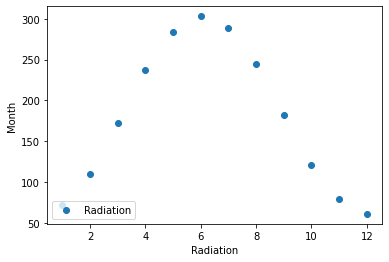

In [7]:
var_names = ['sp_hum','precip','soil_moisture','R_sw','vpd','temp','precip_30d']

final = []
# loop over variable names
for i in range(0, len(var_names)):
    final.append([])
    for number in range(2007, 2016):
        #print(number)
        filename_narr = data_dir + "predictors/narr-%d-NA-monthly.nc" % number
        nc_narr = Dataset(filename_narr, 'r')
        #print(i)
        narr_var = np.array(nc_narr.variables["{}".format(var_names[i])])
        num_rows, num_cols = narr_var.shape
        final[i].extend(narr_var.reshape((num_rows*num_cols, 1),order='F'))

# print(len(final))
# print(len(final[0]))
# print(len(final[0][0]))
X2 = np.array(final) # create numpy array from list

# print(X.shape)
X2 = np.transpose(np.squeeze(X2)) # transpose and remove singular dimension (squeeze)
print(X2.shape)



# double check shape/reshape order

# plot monthly average
print(flux_var.shape)

# reshape to average by month
b = np.reshape(np.ravel(X2[:,3], order='F'), (2613,12,9,-1),order='F')
# average by year
b = np.mean(b,axis=0)

print(b.shape)
# average by month
b = np.mean(b,axis=1)

# print(X_full_av_mon.shape)

# month variable
mon_array = np.arange(1, 13, dtype=float)

# plot monthly averages averaged over all North America
plt.scatter(mon_array,b,label="Radiation")
plt.legend(loc="lower left")

plt.xlabel('Radiation')
plt.ylabel('Month')
plt.show()

In [8]:
def data2grid(lats,lons,data):
    # create grid of lat lon (expand lat by 5 degrees)
    xi = np.arange(lons.min(), lons.max()+1,1)
    yi = np.arange(lats.min(), lats.max()+5,1)
    xi, yi = np.meshgrid(xi, yi)
    zi = np.zeros(yi.shape) # place holder for flux variable

    # loop over values, find index of lat & lon, enter flux variable
    for i in range(len(data)):
        min_temp_lat=abs(lats[i]-yi[:,0])
        min_temp_lon=abs(lons[i]-xi[0,:])
        lat_ind = (min_temp_lat == min(min_temp_lat))
        lon_ind = (min_temp_lon == min(min_temp_lon))
        zi[lat_ind,lon_ind]=data[i]
    return xi, yi, zi

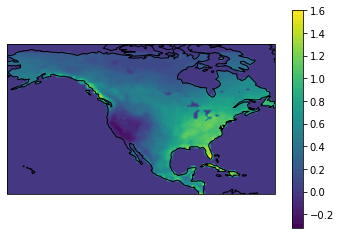

In [21]:
# plotting example

# plot flux data
flux = nc_inv.variables['monthly_flux'][0, :] # note shape of flux is [space dimension x time dimension]

# save lat lon from **MODIS** variable ****<<<<<IMPORTANT>>>>>******
lats = nc_modis.variables['lat'][:]
lons = nc_modis.variables['lon'][:]

xi, yi, zi_flux = data2grid(lats,lons,flux) # regrid for plotting

# projection axis
ax = plt.axes(projection=ccrs.PlateCarree())

# plot contour of variable using gridded  lat, lon, and variable
plt.contourf(xi, yi, zi_flux, 60,
             transform=ccrs.PlateCarree())
# add coasts
ax.coastlines()


plt.colorbar()
plt.show()


[Text(0.5, 1.0, 'Month: December')]

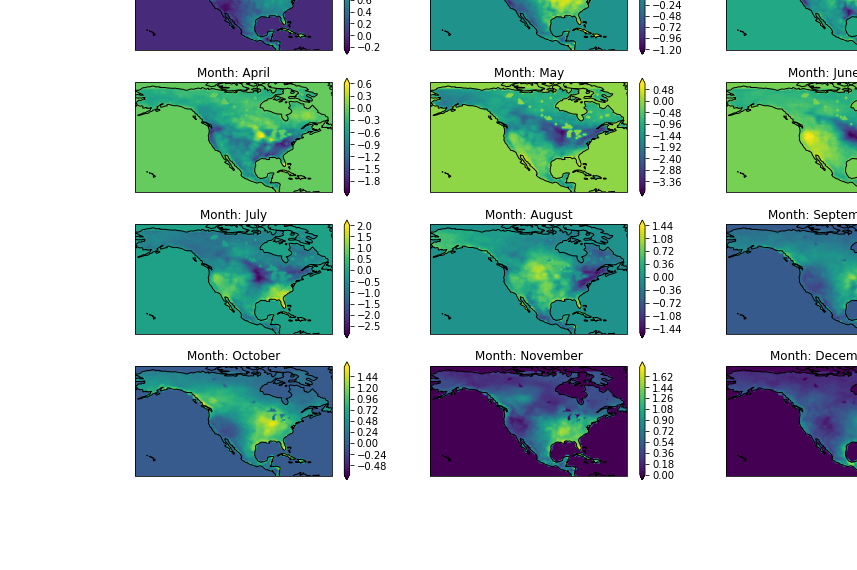

In [20]:
fig, ((ax1, ax2, ax3), 
      (ax4, ax5, ax6), 
      (ax7, ax8, ax9), 
      (ax10, ax11, ax12)) = plt.subplots( 4,3, 
            subplot_kw={'projection': ccrs.PlateCarree()}, figsize=(15,10))

lats = nc_modis.variables['lat'][:]
lons = nc_modis.variables['lon'][:]


currentMonth=1
Flux = flux_var[2613*(currentMonth):2613*(currentMonth+1)].reshape(1,2613).mean(axis=0)
xi, yi, zi = data2grid(lats,lons,Flux)
a1=ax1.contourf(xi, yi, zi, 60, transform=ccrs.PlateCarree(),extend='both', origin='lower')
fig.colorbar(a1,ax=ax1)
ax1.coastlines()
ax1.set(title=('Month: ' + monthsArr[currentMonth-1]))

currentMonth=2
Flux = flux_var[2613*(currentMonth):2613*(currentMonth+1)].reshape(1,2613).mean(axis=0)
xi, yi, zi = data2grid(lats,lons,Flux)
a2=ax2.contourf(xi, yi, zi, 60, transform=ccrs.PlateCarree(),extend='both', origin='lower')
fig.colorbar(a2,ax=ax2)
ax2.coastlines()
ax2.set(title=('Month: ' + monthsArr[currentMonth-1]))

currentMonth=3
Flux = flux_var[2613*(currentMonth):2613*(currentMonth+1)].reshape(1,2613).mean(axis=0)
xi, yi, zi = data2grid(lats,lons,Flux)
a3=ax3.contourf(xi, yi, zi, 60, transform=ccrs.PlateCarree(),extend='both', origin='lower')
fig.colorbar(a3,ax=ax3)
ax3.coastlines()
ax3.set(title=('Month: ' + monthsArr[currentMonth-1]))

currentMonth=4
Flux = flux_var[2613*(currentMonth):2613*(currentMonth+1)].reshape(1,2613).mean(axis=0)
xi, yi, zi = data2grid(lats,lons,Flux)
a4=ax4.contourf(xi, yi, zi, 60, transform=ccrs.PlateCarree(),extend='both', origin='lower')
fig.colorbar(a4,ax=ax4)
ax4.coastlines()
ax4.set(title=('Month: ' + monthsArr[currentMonth-1]))

currentMonth=5
Flux = flux_var[2613*(currentMonth):2613*(currentMonth+1)].reshape(1,2613).mean(axis=0)
xi, yi, zi = data2grid(lats,lons,Flux)
a5=ax5.contourf(xi, yi, zi, 60, transform=ccrs.PlateCarree(),extend='both', origin='lower')
fig.colorbar(a5,ax=ax5)
ax5.coastlines()
ax5.set(title=('Month: ' + monthsArr[currentMonth-1]))

currentMonth=6
Flux = flux_var[2613*(currentMonth):2613*(currentMonth+1)].reshape(1,2613).mean(axis=0)
xi, yi, zi = data2grid(lats,lons,Flux)
a6=ax6.contourf(xi, yi, zi, 60, transform=ccrs.PlateCarree(),extend='both', origin='lower')
fig.colorbar(a6,ax=ax6)
ax6.coastlines()
ax6.set(title=('Month: ' + monthsArr[currentMonth-1]))

currentMonth=7
Flux = flux_var[2613*(currentMonth):2613*(currentMonth+1)].reshape(1,2613).mean(axis=0)
xi, yi, zi = data2grid(lats,lons,Flux)
a7=ax7.contourf(xi, yi, zi, 60, transform=ccrs.PlateCarree(),extend='both', origin='lower')
fig.colorbar(a7,ax=ax7)
ax7.coastlines()
ax7.set(title=('Month: ' + monthsArr[currentMonth-1]))

currentMonth=8
Flux = flux_var[2613*(currentMonth):2613*(currentMonth+1)].reshape(1,2613).mean(axis=0)
xi, yi, zi = data2grid(lats,lons,Flux)
a8=ax8.contourf(xi, yi, zi, 60, transform=ccrs.PlateCarree(),extend='both', origin='lower')
fig.colorbar(a8,ax=ax8)
ax8.coastlines()
ax8.set(title=('Month: ' + monthsArr[currentMonth-1]))

currentMonth=9
Flux = flux_var[2613*(currentMonth):2613*(currentMonth+1)].reshape(1,2613).mean(axis=0)
xi, yi, zi = data2grid(lats,lons,Flux)
a9=ax9.contourf(xi, yi, zi, 60, transform=ccrs.PlateCarree(),extend='both', origin='lower')
fig.colorbar(a9,ax=ax9)
ax9.coastlines()
ax9.set(title=('Month: ' + monthsArr[currentMonth-1]))

currentMonth=10
Flux = flux_var[2613*(currentMonth):2613*(currentMonth+1)].reshape(1,2613).mean(axis=0)
xi, yi, zi = data2grid(lats,lons,Flux)
a10=ax10.contourf(xi, yi, zi, 60, transform=ccrs.PlateCarree(),extend='both', origin='lower')
fig.colorbar(a10,ax=ax10)
ax10.coastlines()
ax10.set(title=('Month: ' + monthsArr[currentMonth-1]))

currentMonth=11
Flux = flux_var[2613*(currentMonth):2613*(currentMonth+1)].reshape(1,2613).mean(axis=0)
xi, yi, zi = data2grid(lats,lons,Flux)
a11=ax11.contourf(xi, yi, zi, 60, transform=ccrs.PlateCarree(),extend='both', origin='lower')
fig.colorbar(a11,ax=ax11)
ax11.coastlines()
ax11.set(title=('Month: ' + monthsArr[currentMonth-1]))

currentMonth=12
Flux = flux_var[2613*(currentMonth):2613*(currentMonth+1)].reshape(1,2613).mean(axis=0)
xi, yi, zi = data2grid(lats,lons,Flux)
a12=ax12.contourf(xi, yi, zi, 60, transform=ccrs.PlateCarree(),extend='both', origin='lower')
fig.colorbar(a12,ax=ax12)
ax12.coastlines()
ax12.set(title=('Month: ' + monthsArr[currentMonth-1]))


In [11]:
X_pars = np.concatenate((X2[:,3:6],month_vec),axis=1) # radiation, vpd, temp, 30d precip
X_narr = np.concatenate((X2,month_vec),axis=1) # All NARR
X_narr_sif = np.concatenate((X2,sif_var2A,month_vec),axis=1) # ALL NARR plus sif


X_full = np.concatenate((X2,sif_var2A,nirv_var,lon_var_all,lat_var_all,month_vec),axis=1)
print(X_full.shape[1])

12


In [12]:
X_train = X_full[0:2613*8*12,:] # train on first 8 years
y_train = flux_var[0:2613*8*12] # train on first 8 years

X_test = X_full[2613*8*12:,:] # test on last year
y_test = flux_var[2613*8*12:] # test on last year

# transform for NN

# scaler_x = preprocessing.StandardScaler() # scaling zero mean unit variance
#scaler_y = preprocessing.StandardScaler() # scaling zero mean unit variance

# scale predictors between 0-1
scaler_x_train = preprocessing.MinMaxScaler(feature_range=(0, 1))
scaler_x_train.fit(X_train)
#scaler_y_train = preprocessing.MinMaxScaler(feature_range=(0, 1))

# try quantile transformation of flux data see: https://machinelearningmastery.com/quantile-transforms-for-machine-learning/
scaler_y_train = QuantileTransformer(random_state=0)
scaler_y_train.fit(y_train)

X_train = scaler_x_train.fit_transform(X_train) # transform training predictors data
y_train = scaler_y_train.fit_transform(y_train) # transform training flux data

scaler_x_test = preprocessing.MinMaxScaler(feature_range=(0, 1))
scaler_x_test.fit(X_test)

#scaler_y_test = preprocessing.MinMaxScaler(feature_range=(0, 1))
scaler_y_test = QuantileTransformer(random_state=0)
scaler_y_test.fit(y_test)


X_test = scaler_x_test.fit_transform(X_test) # transform test predictors data
y_test = scaler_y_test.fit_transform(y_test) # transform test flux data

print(X_train.shape)
print(y_train.shape)

print(X_test.shape)
print(y_test.shape)

(250848, 12)
(250848, 1)
(31356, 12)
(31356, 1)


In [13]:
def plot_loss(history):
  plt.plot(history.history['loss'], label='loss')
  plt.plot(history.history['val_loss'], label='val_loss')
  plt.ylim([0, 0.6])
  plt.xlabel('Epoch')
  plt.ylabel('MSE Error [flux]')
  plt.legend()
  plt.grid(True)

In [14]:




linear_model = Sequential()
linear_model.add(Dense(1,input_dim=X_full.shape[1], activation='relu'))
x = tf.ones((1, X_full.shape[1]))
yt = linear_model(x)
print("Number of weights after calling the model:", len(linear_model.weights))
optimizer = keras.optimizers.SGD()
linear_model.compile(loss='mae', optimizer=optimizer, metrics=['mae'])

Number of weights after calling the model: 2


Epoch 1/5
6272/6272 - 4s - loss: 0.1704 - mae: 0.1704 - val_loss: 0.1473 - val_mae: 0.1473
Epoch 2/5
6272/6272 - 4s - loss: 0.1346 - mae: 0.1346 - val_loss: 0.1436 - val_mae: 0.1436
Epoch 3/5
6272/6272 - 4s - loss: 0.1334 - mae: 0.1334 - val_loss: 0.1428 - val_mae: 0.1428
Epoch 4/5
6272/6272 - 4s - loss: 0.1332 - mae: 0.1332 - val_loss: 0.1416 - val_mae: 0.1416
Epoch 5/5
6272/6272 - 4s - loss: 0.1331 - mae: 0.1331 - val_loss: 0.1423 - val_mae: 0.1423


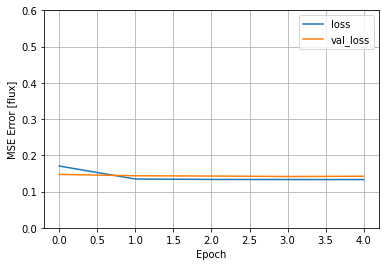

In [15]:
# 5 Epochs

history = linear_model.fit(
    X_train, y_train,
    epochs=5,
    # suppress logging
    verbose=2,
    # Calculate validation results on 20% of the training data
    validation_split = 0.2)
plot_loss(history)

[[1.         0.63321278]
 [0.63321278 1.        ]]


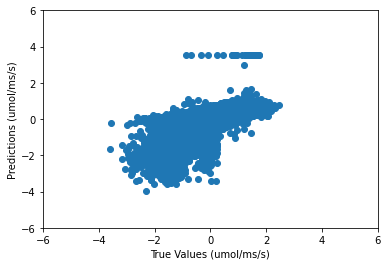

In [16]:
test_results ={}
test_results['linear_model'] = linear_model.evaluate(
    X_test, y_test, verbose=0)
y_est = scaler_y_test.inverse_transform(linear_model.predict(X_test))
a = plt.axes
plt.scatter(scaler_y_test.inverse_transform(y_test),y_est)
plt.xlabel('True Values (umol/ms/s)')
plt.ylabel('Predictions (umol/ms/s)')
plt.ylim(-6, 6)   # set the xlim to left, right
plt.xlim(-6, 6)
var1=scaler_y_test.inverse_transform(y_test)
var2=y_est
print(np.corrcoef(var1,var2,rowvar=False))

In [17]:
linear_model = Sequential()
linear_model.add(Dense(15,input_dim=X_full.shape[1], activation='sigmoid'))
linear_model.add(Dense(1,input_dim=X_full.shape[1], activation='sigmoid'))
x = tf.ones((1, X_full.shape[1]))
yt = linear_model(x)
print("Number of weights after calling the model:", len(linear_model.weights))
optimizer = keras.optimizers.Adam(0.1)
linear_model.compile(loss='mae', optimizer=optimizer, metrics=['mae'])


Number of weights after calling the model: 4


Epoch 1/20
6272/6272 - 5s - loss: 0.1110 - mae: 0.1110 - val_loss: 0.1177 - val_mae: 0.1177
Epoch 2/20
6272/6272 - 4s - loss: 0.1031 - mae: 0.1031 - val_loss: 0.1031 - val_mae: 0.1031
Epoch 3/20
6272/6272 - 4s - loss: 0.1017 - mae: 0.1017 - val_loss: 0.1190 - val_mae: 0.1190
Epoch 4/20
6272/6272 - 4s - loss: 0.1014 - mae: 0.1014 - val_loss: 0.1185 - val_mae: 0.1185
Epoch 5/20
6272/6272 - 4s - loss: 0.1013 - mae: 0.1013 - val_loss: 0.1055 - val_mae: 0.1055
Epoch 6/20
6272/6272 - 4s - loss: 0.1006 - mae: 0.1006 - val_loss: 0.1030 - val_mae: 0.1030
Epoch 7/20
6272/6272 - 4s - loss: 0.1007 - mae: 0.1007 - val_loss: 0.1241 - val_mae: 0.1241
Epoch 8/20
6272/6272 - 4s - loss: 0.1005 - mae: 0.1005 - val_loss: 0.1129 - val_mae: 0.1129
Epoch 9/20
6272/6272 - 4s - loss: 0.1000 - mae: 0.1000 - val_loss: 0.1238 - val_mae: 0.1238
Epoch 10/20
6272/6272 - 4s - loss: 0.0993 - mae: 0.0993 - val_loss: 0.1060 - val_mae: 0.1060
Epoch 11/20
6272/6272 - 4s - loss: 0.0986 - mae: 0.0986 - val_loss: 0.1022 - va

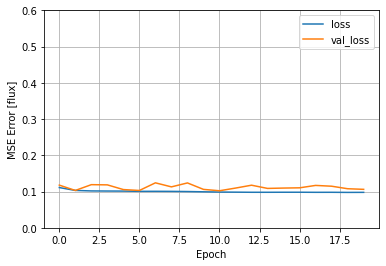

In [18]:
history = linear_model.fit(
    X_train, y_train,
    epochs=20,
    # suppress logging
    verbose=2,
    # Calculate validation results on 20% of the training data
    validation_split = 0.2)
plot_loss(history)

[[1.         0.88992497]
 [0.88992497 1.        ]]


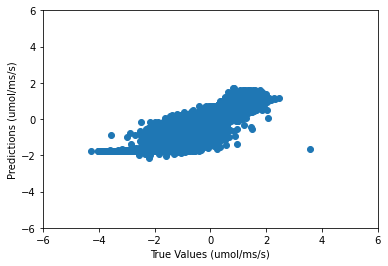

In [19]:
test_results ={}
test_results['linear_model'] = linear_model.evaluate(
    X_test, y_test, verbose=0)
y_est = scaler_y_test.inverse_transform(linear_model.predict(X_test))
a = plt.axes
plt.scatter(scaler_y_test.inverse_transform(y_test),y_est )
plt.xlabel('True Values (umol/ms/s)')
plt.ylabel('Predictions (umol/ms/s)')
plt.ylim(-6, 6)
plt.xlim(-6, 6)
var1=scaler_y_test.inverse_transform(y_test)
var2=y_est
print(np.corrcoef(var1,var2,rowvar=False))


In [20]:
col_names = var_names + ['SIF' , 'Month','Flux']
print(col_names)
df = pd.DataFrame(np.concatenate((X_narr_sif,flux_var),axis=1), columns = col_names)

train_dataset = df.sample(frac=0.8, random_state=0)
test_dataset = df.drop(train_dataset.index)

sns.pairplot(train_dataset[['sp_hum','soil_moisture','R_sw','vpd','temp','precip','precip_30d']], diag_kind='kde')

['sp_hum', 'precip', 'soil_moisture', 'R_sw', 'vpd', 'temp', 'precip_30d', 'SIF', 'Month', 'Flux']


Error in callback <function flush_figures at 0x7ff7edd03550> (for post_execute):


KeyboardInterrupt: 

In [ ]:

# https://stackoverflow.com/questions/53697814/using-pip-install-to-install-cartopy-but-missing-proj-version-at-least-4-9-0
# https://stackoverflow.com/questions/45632549/why-is-the-accuracy-for-my-keras-model-always-0-when-training
# https://stackoverflow.com/questions/61980349/tensorflow-typeerror-cannot-unpack-non-iterable-float-object
# https://www.tensorflow.org/guide/keras/train_and_evaluate

(282204, 6)
(282204, 1)
(12, 9, 1)
(250848, 6)
(250848, 1)
(31356, 6)
(31356, 1)
Epoch 1/100
980/980 - 1s - loss: 0.1851 - mae: 0.1851 - val_loss: 0.1840 - val_mae: 0.1840
Epoch 2/100
980/980 - 1s - loss: 0.1704 - mae: 0.1704 - val_loss: 0.1761 - val_mae: 0.1761
Epoch 3/100
980/980 - 1s - loss: 0.1675 - mae: 0.1675 - val_loss: 0.1756 - val_mae: 0.1756
Epoch 4/100
980/980 - 1s - loss: 0.1656 - mae: 0.1656 - val_loss: 0.1719 - val_mae: 0.1719
Epoch 5/100
980/980 - 1s - loss: 0.1637 - mae: 0.1637 - val_loss: 0.1736 - val_mae: 0.1736
Epoch 6/100
980/980 - 1s - loss: 0.1624 - mae: 0.1624 - val_loss: 0.1732 - val_mae: 0.1732
Epoch 7/100
980/980 - 1s - loss: 0.1615 - mae: 0.1615 - val_loss: 0.1752 - val_mae: 0.1752
Epoch 8/100
980/980 - 1s - loss: 0.1604 - mae: 0.1604 - val_loss: 0.1723 - val_mae: 0.1723
Epoch 9/100
980/980 - 1s - loss: 0.1595 - mae: 0.1595 - val_loss: 0.1759 - val_mae: 0.1759
Epoch 10/100
980/980 - 1s - loss: 0.1585 - mae: 0.1585 - val_loss: 0.1718 - val_mae: 0.1718
Epoch 11

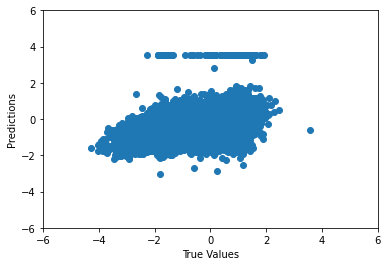

In [21]:
var_names = ['sp_hum','precip','soil_moisture','vpd','temp','precip_30d']



final = []
# loop over variable names
for i in range(0, len(var_names)):
    final.append([])
    for number in range(2007, 2016):
        #print(number)
        filename_narr = data_dir + "predictors/narr-%d-NA-monthly.nc" % number
        nc_narr = Dataset(filename_narr, 'r')
        #print(i)
        narr_var = np.array(nc_narr.variables["{}".format(var_names[i])])
        num_rows, num_cols = narr_var.shape
        final[i].extend(narr_var.reshape((num_rows*num_cols, 1),order='F'))

# print(len(final))
# print(len(final[0]))
# print(len(final[0][0]))
X2 = np.array(final) # create numpy array from list

# print(X.shape)
X2 = np.transpose(np.squeeze(X2)) # transpose and remove singular dimension (squeeze)
print(X2.shape)



# double check shape/reshape order

# plot monthly average
print(flux_var.shape)


b = np.reshape(np.ravel(X2[:,3], order='F'), (2613,12,9,-1),order='F')

b = np.mean(b,axis=0)

print(b.shape)

b = np.mean(b,axis=1)

mon_array = np.arange(1, 13, dtype=float)

# remove nirv_var
X_full = X2


X_train = X_full[0:2613*8*12,:] # train on first 8 years
y_train = flux_var[0:2613*8*12] # train on first 8 years

X_test = X_full[2613*8*12:,:] # test on last year
y_test = flux_var[2613*8*12:] # test on last year

# transform for NN

# scaler_x = preprocessing.StandardScaler() # scaling zero mean unit variance
#scaler_y = preprocessing.StandardScaler() # scaling zero mean unit variance

# scale predictors between 0-1
scaler_x_train = preprocessing.MinMaxScaler(feature_range=(0, 1))
scaler_x_train.fit(X_train)
#scaler_y_train = preprocessing.MinMaxScaler(feature_range=(0, 1))

# try quantile transformation of flux data see: https://machinelearningmastery.com/quantile-transforms-for-machine-learning/
scaler_y_train = QuantileTransformer(random_state=0)
scaler_y_train.fit(y_train)

X_train = scaler_x_train.fit_transform(X_train) # transform training predictors data
y_train = scaler_y_train.fit_transform(y_train) # transform training flux data

scaler_x_test = preprocessing.MinMaxScaler(feature_range=(0, 1))
scaler_x_test.fit(X_test)

#scaler_y_test = preprocessing.MinMaxScaler(feature_range=(0, 1))
scaler_y_test = QuantileTransformer(random_state=0)
scaler_y_test.fit(y_test)


X_test = scaler_x_test.fit_transform(X_test) # transform test predictors data
y_test = scaler_y_test.fit_transform(y_test) # transform test flux data

print(X_train.shape)
print(y_train.shape)

print(X_test.shape)
print(y_test.shape)

med_model = Sequential()
med_model.add(Dense(50,input_dim=X_full.shape[1], activation='relu'))
med_model.add(Dense(70,input_dim=X_full.shape[1], activation='relu'))
med_model.add(Dense(70,input_dim=X_full.shape[1], activation='relu'))
med_model.add(Dense(50,input_dim=X_full.shape[1], activation='relu'))
med_model.add(Dense(1,input_dim=X_full.shape[1], activation='linear'))
x = tf.ones((1, X_full.shape[1]))
yt = med_model(x)
optimizer = keras.optimizers.Adam()
med_model.compile(loss='mae', optimizer=optimizer, metrics=['mae'])

med_model_history=med_model.fit(
    X_train, y_train,
    epochs=100,
    verbose=2,
    batch_size=256,
    shuffle = True,

   validation_data=(X_test, y_test))
    
test_results ={}
test_results['med_model'] = med_model.evaluate(
    X_test, y_test, verbose=0)
y_est = scaler_y_test.inverse_transform(med_model.predict(X_test))
a = plt.axes
#     axs[i-1].xlabel('True Values')
#     axs[i-1].ylabel('Predictions')
#     axs[i-1].ylim(-6, 6)
#     axs[i-1].xlim(-6, 6)
var1=scaler_y_test.inverse_transform(y_test)
var2=y_est
a = plt.axes
plt.scatter(scaler_y_test.inverse_transform(y_test),y_est )
plt.xlabel('True Values')
plt.ylabel('Predictions')
plt.ylim(-6, 6)
plt.xlim(-6, 6)
var1=scaler_y_test.inverse_transform(y_test)
var2=y_est
print(np.corrcoef(var1,var2,rowvar=False))

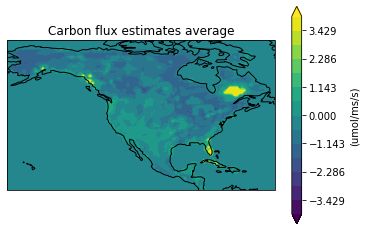

In [22]:
a = np.reshape(np.ravel(y_est, order='F'), (2613,12,1,-1),order='F') 

xi, yi, zi_flux = data2grid(lats,lons,a[:,6]) # regrid for plotting
#xi, yi, zi_flux = data2grid(lats,lons,flux) # regrid for plotting

# projection axis  
ax = plt.axes(projection=ccrs.PlateCarree())
levels = np.linspace(-4, 4, 15)


# plot contour of variable using gridded  lat, lon, and variable
plt.contourf(xi, yi, zi_flux, 60,levels=levels,
             transform=ccrs.PlateCarree(),extend='both')
# plt.clim(-1.6,1.6)

# add coasts
ax.coastlines()

# title
plt.title("Carbon flux estimates average")
cbr=plt.colorbar()
cbr.set_label('(umol/ms/s)')
plt.show()

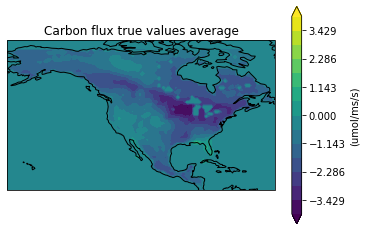

In [23]:
realvals = np.reshape(np.ravel(scaler_y_test.inverse_transform(y_test), order='F'), (2613,12,1,-1),order='F') 

xi, yi, zi_flux = data2grid(lats,lons,realvals[:,6]) 

ax = plt.axes(projection=ccrs.PlateCarree())
levels = np.linspace(-4, 4, 15)

plt.contourf(xi, yi, zi_flux, 60,levels=levels,
             transform=ccrs.PlateCarree(),extend='both')

ax.coastlines()

plt.title("Carbon flux true values average")
cbr=plt.colorbar()
cbr.set_label('(umol/ms/s)')
plt.show()

(282204, 8)
(282204, 1)
(12, 9, 1)
10
(250848, 10)
(250848, 1)
(31356, 10)
(31356, 1)
Epoch 1/100
980/980 - 5s - loss: 0.2870 - mae: 0.2870 - val_loss: 0.1340 - val_mae: 0.1340
Epoch 2/100
980/980 - 5s - loss: 0.1525 - mae: 0.1525 - val_loss: 0.1285 - val_mae: 0.1285
Epoch 3/100
980/980 - 4s - loss: 0.1441 - mae: 0.1441 - val_loss: 0.1227 - val_mae: 0.1227
Epoch 4/100
980/980 - 4s - loss: 0.1390 - mae: 0.1390 - val_loss: 0.1189 - val_mae: 0.1189
Epoch 5/100
980/980 - 4s - loss: 0.1354 - mae: 0.1354 - val_loss: 0.1187 - val_mae: 0.1187
Epoch 6/100
980/980 - 4s - loss: 0.1326 - mae: 0.1326 - val_loss: 0.1175 - val_mae: 0.1175
Epoch 7/100
980/980 - 5s - loss: 0.1303 - mae: 0.1303 - val_loss: 0.1184 - val_mae: 0.1184
Epoch 8/100
980/980 - 5s - loss: 0.1286 - mae: 0.1286 - val_loss: 0.1150 - val_mae: 0.1150
Epoch 9/100
980/980 - 5s - loss: 0.1266 - mae: 0.1266 - val_loss: 0.1151 - val_mae: 0.1151
Epoch 10/100
980/980 - 4s - loss: 0.1257 - mae: 0.1257 - val_loss: 0.1206 - val_mae: 0.1206
Epo

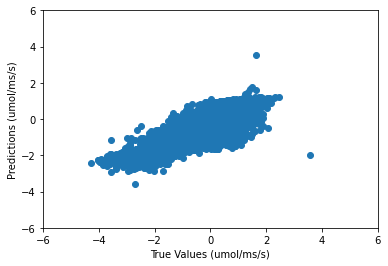

In [24]:
from keras.layers import BatchNormalization
from keras.layers import Dropout
var_names = ['sp_hum','precip','soil_moisture','vpd','temp','precip_30d', 'R_sw', 'rel_hum']

# R_sw

final = []
# loop over variable names
for i in range(0, len(var_names)):
    final.append([])
    for number in range(2007, 2016):
        #print(number)
        filename_narr = data_dir + "predictors/narr-%d-NA-monthly.nc" % number
        nc_narr = Dataset(filename_narr, 'r')
        #print(i)
        narr_var = np.array(nc_narr.variables["{}".format(var_names[i])])
        num_rows, num_cols = narr_var.shape
        final[i].extend(narr_var.reshape((num_rows*num_cols, 1),order='F'))

# print(len(final))
# print(len(final[0]))
# print(len(final[0][0]))
X2 = np.array(final) # create numpy array from list

# print(X.shape)
X2 = np.transpose(np.squeeze(X2)) # transpose and remove singular dimension (squeeze)
print(X2.shape)



# double check shape/reshape order

# plot monthly average
print(flux_var.shape)


b = np.reshape(np.ravel(X2[:,3], order='F'), (2613,12,9,-1),order='F')

b = np.mean(b,axis=0)

print(b.shape)

b = np.mean(b,axis=1)

mon_array = np.arange(1, 13, dtype=float)

X_pars = np.concatenate((X2[:,3:6],month_vec),axis=1) # radiation, vpd, temp, 30d precip
X_narr = np.concatenate((X2,month_vec),axis=1) # All NARR
X_narr_sif = np.concatenate((X2,sif_var2A,month_vec),axis=1) # ALL NARR plus sif


X_full = np.concatenate((X2,sif_var2A,nirv_var),axis=1)
print(X_full.shape[1])


X_train = X_full[0:2613*8*12,:] # train on first 8 years
y_train = flux_var[0:2613*8*12] # train on first 8 years

X_test = X_full[2613*8*12:,:] # test on last year
y_test = flux_var[2613*8*12:] # test on last year

# transform for NN

# scaler_x = preprocessing.StandardScaler() # scaling zero mean unit variance
#scaler_y = preprocessing.StandardScaler() # scaling zero mean unit variance

# scale predictors between 0-1
scaler_x_train = preprocessing.MinMaxScaler(feature_range=(0, 1))
scaler_x_train.fit(X_train)
#scaler_y_train = preprocessing.MinMaxScaler(feature_range=(0, 1))

# try quantile transformation of flux data see: https://machinelearningmastery.com/quantile-transforms-for-machine-learning/
scaler_y_train = QuantileTransformer(random_state=0)
scaler_y_train.fit(y_train)

X_train = scaler_x_train.fit_transform(X_train) # transform training predictors data
y_train = scaler_y_train.fit_transform(y_train) # transform training flux data

scaler_x_test = preprocessing.MinMaxScaler(feature_range=(0, 1))
scaler_x_test.fit(X_test)

#scaler_y_test = preprocessing.MinMaxScaler(feature_range=(0, 1))
scaler_y_test = QuantileTransformer(random_state=0)
scaler_y_test.fit(y_test)


X_test = scaler_x_test.fit_transform(X_test) # transform test predictors data
y_test = scaler_y_test.fit_transform(y_test) # transform test flux data

print(X_train.shape)
print(y_train.shape)

print(X_test.shape)
print(y_test.shape)

large_model = Sequential()
large_model.add(Dense(50,input_dim=X_full.shape[1], activation='relu'))
large_model.add(BatchNormalization())
large_model.add(Dropout(.25))
large_model.add(Dense(100,input_dim=X_full.shape[1], activation='relu'))
large_model.add(BatchNormalization())
large_model.add(Dropout(.25))
large_model.add(Dense(100,input_dim=X_full.shape[1], activation='relu'))
large_model.add(BatchNormalization())
large_model.add(Dropout(.25))
large_model.add(Dense(100,input_dim=X_full.shape[1], activation='relu'))
large_model.add(BatchNormalization())
large_model.add(Dropout(.25))
large_model.add(Dense(50,input_dim=X_full.shape[1], activation='relu'))
large_model.add(BatchNormalization())
large_model.add(Dropout(.25))
large_model.add(Dense(50,input_dim=X_full.shape[1], activation='relu'))
large_model.add(BatchNormalization())
large_model.add(Dropout(.25))
large_model.add(Dense(1,input_dim=X_full.shape[1], activation='linear'))
x = tf.ones((1, X_full.shape[1]))
yt = large_model(x)
optimizer = keras.optimizers.Adam()
large_model.compile(loss='mae', optimizer=optimizer, metrics=['mae'])

large_model_history=large_model.fit(
    X_train, y_train,
    epochs=100,
    verbose=2,
    batch_size=256,
    shuffle = True,

   validation_data=(X_test, y_test))
    
test_results ={}
test_results['large_model'] = large_model.evaluate(
    X_test, y_test, verbose=0)
y_est = scaler_y_test.inverse_transform(large_model.predict(X_test))
a = plt.axes
#     axs[i-1].xlabel('True Values')
#     axs[i-1].ylabel('Predictions')
#     axs[i-1].ylim(-6, 6)
#     axs[i-1].xlim(-6, 6)
var1=scaler_y_test.inverse_transform(y_test)
var2=y_est
a = plt.axes
plt.scatter(scaler_y_test.inverse_transform(y_test),y_est )
plt.xlabel('True Values (umol/ms/s)')
plt.ylabel('Predictions (umol/ms/s)')
plt.ylim(-6, 6)
plt.xlim(-6, 6)
var1=scaler_y_test.inverse_transform(y_test)
var2=y_est
print(np.corrcoef(var1,var2,rowvar=False))

# 0.813  without batch normalization and dropout


[Text(0.5, 1.0, 'Carbon Flux Differences - June')]

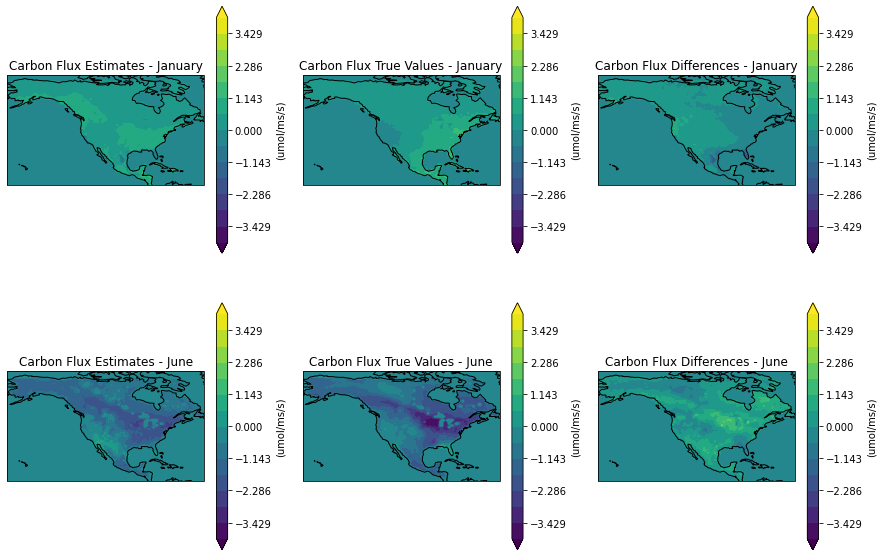

In [25]:
fig, ((ax1, ax2, ax3), 
      (ax4, ax5, ax6)) = plt.subplots( 2,3, 
            subplot_kw={'projection': ccrs.PlateCarree()}, figsize=(15,10))

a = np.reshape(np.ravel(y_est, order='F'), (2613,12,1,-1),order='F') 
realvals = np.reshape(np.ravel(scaler_y_test.inverse_transform(y_test), order='F'), (2613,12,1,-1),order='F') 
levels = np.linspace(-4, 4, 15)


xi, yi, zi_flux = data2grid(lats,lons,a[:,1])
a1=ax1.contourf(xi, yi, zi_flux, 60,levels=levels,
             transform=ccrs.PlateCarree(),extend='both')

cbr=fig.colorbar(a1,ax=ax1)
cbr.set_label('(umol/ms/s)')
ax1.coastlines()
ax1.set(title=('Carbon Flux Estimates - January'))
        
        
xi, yi, zi_flux = data2grid(lats,lons,realvals[:,1])
a2=ax2.contourf(xi, yi, zi_flux, 60,levels=levels,
             transform=ccrs.PlateCarree(),extend='both')

cbr=fig.colorbar(a2,ax=ax2)
cbr.set_label('(umol/ms/s)')
ax2.coastlines()
ax2.set(title=('Carbon Flux True Values - January'))
        
diffs = a-realvals

xi, yi, zi_flux = data2grid(lats,lons,diffs[:, 1]) 
a3=ax3.contourf(xi, yi, zi_flux, 60,levels=levels,
    transform=ccrs.PlateCarree(),extend='both')


cbr=fig.colorbar(a3,ax=ax3)
cbr.set_label('(umol/ms/s)')
ax3.coastlines()
ax3.set(title=('Carbon Flux Differences - January'))




xi, yi, zi_flux = data2grid(lats,lons,a[:,6])
a4=ax4.contourf(xi, yi, zi_flux, 60,levels=levels,
             transform=ccrs.PlateCarree(),extend='both')


cbr=fig.colorbar(a4,ax=ax4)
cbr.set_label('(umol/ms/s)')
ax4.coastlines()
ax4.set(title=('Carbon Flux Estimates - June'))
        
        
xi, yi, zi_flux = data2grid(lats,lons,realvals[:,6])
a5=ax5.contourf(xi, yi, zi_flux, 60,levels=levels,
             transform=ccrs.PlateCarree(),extend='both')


cbr=fig.colorbar(a5,ax=ax5)
cbr.set_label('(umol/ms/s)')
ax5.coastlines()
ax5.set(title=('Carbon Flux True Values - June'))
        
diffs = a-realvals

xi, yi, zi_flux = data2grid(lats,lons,diffs[:, 6]) 
a6=ax6.contourf(xi, yi, zi_flux, 60,levels=levels,
    transform=ccrs.PlateCarree(),extend='both')


cbr=fig.colorbar(a6,ax=ax6)
cbr.set_label('(umol/ms/s)')
ax6.coastlines()
ax6.set(title=('Carbon Flux Differences - June'))




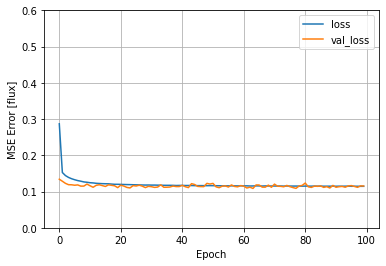

In [26]:
plot_loss(large_model_history)

In [27]:
fluxcom = data_dir + "fluxcom-2007-to-2012-NA-monthly.nc"
fluxcom = Dataset(fluxcom, 'r')  # open data file using netcdf reader


fluxcom_var = np.array(fluxcom.variables['FluxCom-ANN::NEE']) 
num_rows, num_cols = fluxcom_var.shape

fluxcom_var = fluxcom_var.reshape((num_rows*num_cols, 1),order='F') 
print(fluxcom_var.shape)
fluxcom_var=fluxcom_var[0: 31356]
print(fluxcom_var.shape)
print(y_test.shape)

(188136, 1)
(31356, 1)
(31356, 1)


In [28]:
print(fluxcom_var)
print(y_test)

[[-0.55871633]
 [-0.86203155]
 [-1.18418195]
 ...
 [-0.11118916]
 [-0.08439272]
 [-0.24568092]]
[[0.99319557]
 [0.98932448]
 [0.99699764]
 ...
 [0.52222681]
 [0.5263917 ]
 [0.53037997]]


[[[ 0.13092845]]

 [[ 0.09390846]]

 [[ 0.04950409]]

 [[-0.17327118]]

 [[-0.63484196]]

 [[-1.28776234]]

 [[-1.24568278]]

 [[-0.71430764]]

 [[-0.20482456]]

 [[ 0.08054943]]

 [[ 0.15040864]]

 [[ 0.1353508 ]]]
[[ 0.13092845]
 [ 0.09390846]
 [ 0.04950409]
 [-0.17327118]
 [-0.63484196]
 [-1.28776234]
 [-1.24568278]
 [-0.71430764]
 [-0.20482456]
 [ 0.08054943]
 [ 0.15040864]
 [ 0.1353508 ]]
0.2173773177753026


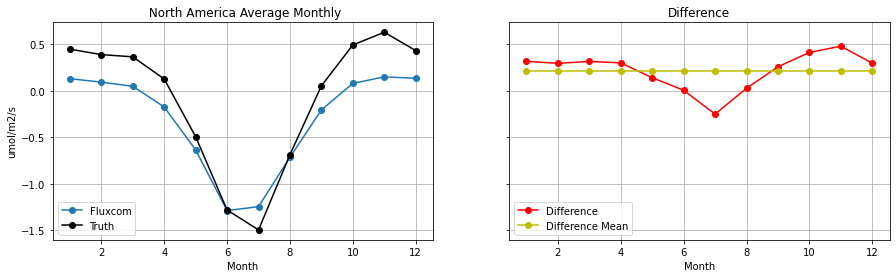

In [29]:
b = np.reshape(np.ravel(scaler_y_test.inverse_transform(y_test), order='F'), (2613,12,1,-1),order='F')
a = np.reshape(np.ravel(fluxcom_var, order='F'), (2613,12,1,-1),order='F')

X_test_mon = np.nanmean(a,axis=0)
X_tru_mon = np.mean(b,axis=0)
print(X_test_mon)


# average by month
X_test_mon = np.nanmean(X_test_mon,axis=1)
X_tru_mon = np.mean(X_tru_mon,axis=1)
print(X_test_mon)
# print(X_full_av_mon.shape)

# month variable
mon_array = np.arange(1, 13, dtype=float)

fig, (ax1, ax2)= plt.subplots(1, 2, figsize=(15,4), sharey=True)

ax1.plot(mon_array,X_test_mon[:,0],'-o',label="Fluxcom")
ax1.plot(mon_array,X_tru_mon[:,0],'-ok',label="Truth")
ax1.set_title(" North America Average Monthly")
ax1.set_xlabel("Month")
ax1.set_ylabel("umol/m2/s")


ax1.legend(loc="lower left")
ax1.grid()

year_diffs=X_tru_mon[:,0]-X_test_mon[:,0]

print(np.mean(year_diffs))
mean_diff_array=[]
for a in mon_array:
    mean_diff_array.append(np.mean(year_diffs))

ax2.plot(mon_array,X_tru_mon[:,0]-X_test_mon[:,0],'-or',label="Difference")
ax2.plot(mon_array, mean_diff_array,'-oy',label="Difference Mean")

ax2.set_title("Difference")
ax2.set_xlabel("Month")

ax2.legend(loc="lower left")
ax2.grid()

In [9]:
filename_land = data_dir + "land_cover_NA_pct_2613.nc"
nc_land = Dataset(filename_land, 'r')  # open data file using netcdf reader
land_var= np.array(nc_land.variables["land_cover_pct"]) # create numpy array note shape of narr vars is [space dimension x time dimension]
land_var_full=np.tile(land_var,(1,9*12))
land_var_full = np.transpose(land_var_full)

print(land_var_full.shape)

(282204, 18)


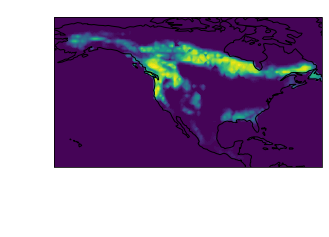

In [14]:
land_var_graph= nc_land.variables["land_cover_pct"]

land_var_graph=np.array(land_var_graph)

graph_data=[]

for i in range(2613):
    temp=[]
    temp.append(land_var_graph[1][i])
    temp=np.mean(temp)
    graph_data.append(temp)

# save lat lon from **MODIS** variable ****<<<<<IMPORTANT>>>>>******
lats = nc_modis.variables['lat'][:]
lons = nc_modis.variables['lon'][:]

xi, yi, zi_flux = data2grid(lats,lons,graph_data) # regrid for plotting

# projection axis
ax = plt.axes(projection=ccrs.PlateCarree())

# plot contour of variable using gridded  lat, lon, and variable
plt.contourf(xi, yi, zi_flux, 60,
             transform=ccrs.PlateCarree())
# add coasts
ax.coastlines()


plt.colorbar()
plt.show()

(282204, 8)
(282204, 1)
(12, 9, 1)
28
(250848, 28)
(250848, 1)
(31356, 28)
(31356, 1)
Epoch 1/100
980/980 - 5s - loss: 0.2705 - mae: 0.2705 - val_loss: 0.1252 - val_mae: 0.1252
Epoch 2/100
980/980 - 5s - loss: 0.1395 - mae: 0.1395 - val_loss: 0.1106 - val_mae: 0.1106
Epoch 3/100
980/980 - 5s - loss: 0.1278 - mae: 0.1278 - val_loss: 0.1054 - val_mae: 0.1054
Epoch 4/100
980/980 - 4s - loss: 0.1213 - mae: 0.1213 - val_loss: 0.1039 - val_mae: 0.1039
Epoch 5/100
980/980 - 4s - loss: 0.1170 - mae: 0.1170 - val_loss: 0.1019 - val_mae: 0.1019
Epoch 6/100
980/980 - 4s - loss: 0.1141 - mae: 0.1141 - val_loss: 0.0983 - val_mae: 0.0983
Epoch 7/100
980/980 - 4s - loss: 0.1114 - mae: 0.1114 - val_loss: 0.0986 - val_mae: 0.0986
Epoch 8/100
980/980 - 4s - loss: 0.1096 - mae: 0.1096 - val_loss: 0.0995 - val_mae: 0.0995
Epoch 9/100
980/980 - 4s - loss: 0.1084 - mae: 0.1084 - val_loss: 0.0952 - val_mae: 0.0952
Epoch 10/100
980/980 - 4s - loss: 0.1076 - mae: 0.1076 - val_loss: 0.0984 - val_mae: 0.0984
Epo

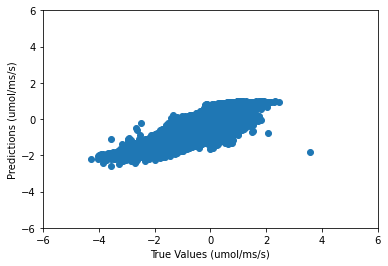

In [31]:
from keras.layers import BatchNormalization
from keras.layers import Dropout
var_names = ['sp_hum','precip','soil_moisture','vpd','temp','precip_30d', 'R_sw', 'rel_hum']

# R_sw

final = []
# loop over variable names
for i in range(0, len(var_names)):
    final.append([])
    for number in range(2007, 2016):
        #print(number)
        filename_narr = data_dir + "predictors/narr-%d-NA-monthly.nc" % number
        nc_narr = Dataset(filename_narr, 'r')
        #print(i)
        narr_var = np.array(nc_narr.variables["{}".format(var_names[i])])
        num_rows, num_cols = narr_var.shape
        final[i].extend(narr_var.reshape((num_rows*num_cols, 1),order='F'))

# print(len(final))
# print(len(final[0]))
# print(len(final[0][0]))
X2 = np.array(final) # create numpy array from list

# print(X.shape)
X2 = np.transpose(np.squeeze(X2)) # transpose and remove singular dimension (squeeze)
print(X2.shape)



# double check shape/reshape order

# plot monthly average
print(flux_var.shape)


b = np.reshape(np.ravel(X2[:,3], order='F'), (2613,12,9,-1),order='F')

b = np.mean(b,axis=0)

print(b.shape)

b = np.mean(b,axis=1)

mon_array = np.arange(1, 13, dtype=float)

X_pars = np.concatenate((X2[:,3:6],month_vec),axis=1) # radiation, vpd, temp, 30d precip
X_narr = np.concatenate((X2,month_vec),axis=1) # All NARR
X_narr_sif = np.concatenate((X2,sif_var2A,month_vec),axis=1) # ALL NARR plus sif


X_full = np.concatenate((X2,sif_var2A,nirv_var, land_var_full),axis=1)
print(X_full.shape[1])


X_train = X_full[0:2613*8*12,:] # train on first 8 years
y_train = flux_var[0:2613*8*12] # train on first 8 years

X_test = X_full[2613*8*12:,:] # test on last year
y_test = flux_var[2613*8*12:] # test on last year

# transform for NN

# scaler_x = preprocessing.StandardScaler() # scaling zero mean unit variance
#scaler_y = preprocessing.StandardScaler() # scaling zero mean unit variance

# scale predictors between 0-1
scaler_x_train = preprocessing.MinMaxScaler(feature_range=(0, 1))
scaler_x_train.fit(X_train)
#scaler_y_train = preprocessing.MinMaxScaler(feature_range=(0, 1))

# try quantile transformation of flux data see: https://machinelearningmastery.com/quantile-transforms-for-machine-learning/
scaler_y_train = QuantileTransformer(random_state=0)
scaler_y_train.fit(y_train)

X_train = scaler_x_train.fit_transform(X_train) # transform training predictors data
y_train = scaler_y_train.fit_transform(y_train) # transform training flux data

scaler_x_test = preprocessing.MinMaxScaler(feature_range=(0, 1))
scaler_x_test.fit(X_test)

#scaler_y_test = preprocessing.MinMaxScaler(feature_range=(0, 1))
scaler_y_test = QuantileTransformer(random_state=0)
scaler_y_test.fit(y_test)


X_test = scaler_x_test.fit_transform(X_test) # transform test predictors data
y_test = scaler_y_test.fit_transform(y_test) # transform test flux data

print(X_train.shape)
print(y_train.shape)

print(X_test.shape)
print(y_test.shape)

large_model = Sequential()
large_model.add(Dense(50,input_dim=X_full.shape[1], activation='relu'))
large_model.add(BatchNormalization())
large_model.add(Dropout(.25))
large_model.add(Dense(100,input_dim=X_full.shape[1], activation='relu'))
large_model.add(BatchNormalization())
large_model.add(Dropout(.25))
large_model.add(Dense(100,input_dim=X_full.shape[1], activation='relu'))
large_model.add(BatchNormalization())
large_model.add(Dropout(.25))
large_model.add(Dense(100,input_dim=X_full.shape[1], activation='relu'))
large_model.add(BatchNormalization())
large_model.add(Dropout(.25))
large_model.add(Dense(50,input_dim=X_full.shape[1], activation='relu'))
large_model.add(BatchNormalization())
large_model.add(Dropout(.25))
large_model.add(Dense(50,input_dim=X_full.shape[1], activation='relu'))
large_model.add(BatchNormalization())
large_model.add(Dropout(.25))
large_model.add(Dense(1,input_dim=X_full.shape[1], activation='linear'))
x = tf.ones((1, X_full.shape[1]))
yt = large_model(x)
optimizer = keras.optimizers.Adam()
large_model.compile(loss='mae', optimizer=optimizer, metrics=['mae'])

large_model_history=large_model.fit(
    X_train, y_train,
    epochs=100,
    verbose=2,
    batch_size=256,
    shuffle = True,

   validation_data=(X_test, y_test))

test_results ={}
test_results['large_model'] = large_model.evaluate(
    X_test, y_test, verbose=0)
y_est = scaler_y_test.inverse_transform(large_model.predict(X_test))
a = plt.axes
#     axs[i-1].xlabel('True Values')
#     axs[i-1].ylabel('Predictions')
#     axs[i-1].ylim(-6, 6)
#     axs[i-1].xlim(-6, 6)
var1=scaler_y_test.inverse_transform(y_test)
var2=y_est
a = plt.axes
plt.scatter(scaler_y_test.inverse_transform(y_test),y_est )
plt.xlabel('True Values (umol/ms/s)')
plt.ylabel('Predictions (umol/ms/s)')
plt.ylim(-6, 6)
plt.xlim(-6, 6)
var1=scaler_y_test.inverse_transform(y_test)
var2=y_est
print(np.corrcoef(var1,var2,rowvar=False))


(12, 1, 1)
0.02096487682617273


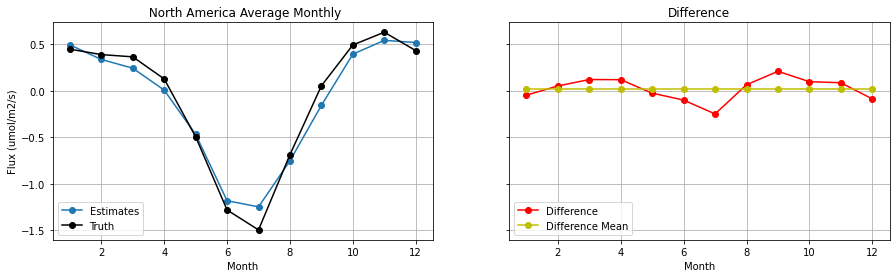

In [32]:
b = np.reshape(np.ravel(scaler_y_test.inverse_transform(y_test), order='F'), (2613,12,1,-1),order='F')
a = np.reshape(np.ravel(y_est, order='F'), (2613,12,1,-1),order='F')

X_test_mon = np.mean(a,axis=0)
X_tru_mon = np.mean(b,axis=0)

print(X_test_mon.shape)
# average by month
X_test_mon = np.mean(X_test_mon,axis=1)
X_tru_mon = np.mean(X_tru_mon,axis=1)

# print(X_full_av_mon.shape)

# month variable
mon_array = np.arange(1, 13, dtype=float)

fig, (ax1, ax2)= plt.subplots(1, 2, figsize=(15,4), sharey=True)

ax1.plot(mon_array,X_test_mon[:,0],'-o',label="Estimates")
ax1.plot(mon_array,X_tru_mon[:,0],'-ok',label="Truth")
ax1.set_title(" North America Average Monthly")
ax1.set_xlabel("Month")
ax1.set_ylabel("Flux (umol/m2/s)")


ax1.legend(loc="lower left")
ax1.grid()

year_diffs=X_tru_mon[:,0]-X_test_mon[:,0]

print(np.mean(year_diffs))
mean_diff_array=[]
for a in mon_array:
    mean_diff_array.append(np.mean(year_diffs))

ax2.plot(mon_array,X_tru_mon[:,0]-X_test_mon[:,0],'-or',label="Difference")
ax2.plot(mon_array, mean_diff_array,'-oy',label="Difference Mean")

ax2.set_title("Difference")
ax2.set_xlabel("Month")

ax2.legend(loc="lower left")
ax2.grid()

[[[ 0.13092845]]

 [[ 0.09390846]]

 [[ 0.04950409]]

 [[-0.17327118]]

 [[-0.63484196]]

 [[-1.28776234]]

 [[-1.24568278]]

 [[-0.71430764]]

 [[-0.20482456]]

 [[ 0.08054943]]

 [[ 0.15040864]]

 [[ 0.1353508 ]]]
[[ 0.13092845]
 [ 0.09390846]
 [ 0.04950409]
 [-0.17327118]
 [-0.63484196]
 [-1.28776234]
 [-1.24568278]
 [-0.71430764]
 [-0.20482456]
 [ 0.08054943]
 [ 0.15040864]
 [ 0.1353508 ]]
0.2173773177753026


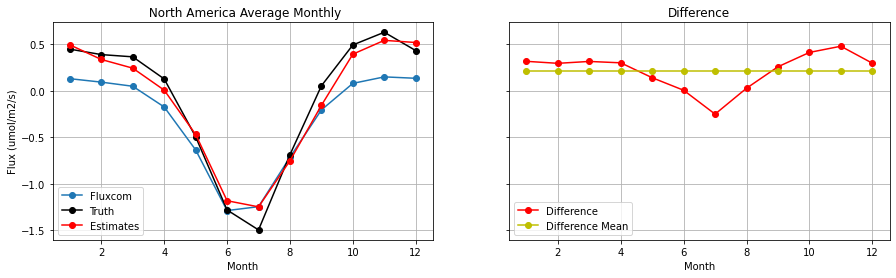

In [33]:
b = np.reshape(np.ravel(scaler_y_test.inverse_transform(y_test), order='F'), (2613,12,1,-1),order='F')
a = np.reshape(np.ravel(fluxcom_var, order='F'), (2613,12,1,-1),order='F')
c = np.reshape(np.ravel(y_est, order='F'), (2613,12,1,-1),order='F')

est_mon = np.mean(c,axis=0)
X_test_mon = np.nanmean(a,axis=0)
X_tru_mon = np.mean(b,axis=0)
print(X_test_mon)


# average by month
X_test_mon = np.nanmean(X_test_mon,axis=1)
X_tru_mon = np.mean(X_tru_mon,axis=1)

est_mon = np.nanmean(est_mon,axis=1)

print(X_test_mon)
# print(X_full_av_mon.shape)

# month variable
mon_array = np.arange(1, 13, dtype=float)

fig, (ax1, ax2)= plt.subplots(1, 2, figsize=(15,4), sharey=True)

ax1.plot(mon_array,X_test_mon[:,0],'-o',label="Fluxcom")
ax1.plot(mon_array,X_tru_mon[:,0],'-ok',label="Truth")
ax1.plot(mon_array,est_mon[:,0],'-or',label="Estimates")
ax1.set_title(" North America Average Monthly")
ax1.set_xlabel("Month")
ax1.set_ylabel("Flux (umol/m2/s)")

ax1.legend(loc="lower left")
ax1.grid()

year_diffs=X_tru_mon[:,0]-X_test_mon[:,0]

print(np.mean(year_diffs))
mean_diff_array=[]
for a in mon_array:
    mean_diff_array.append(np.mean(year_diffs))

ax2.plot(mon_array,X_tru_mon[:,0]-X_test_mon[:,0],'-or',label="Difference")
ax2.plot(mon_array, mean_diff_array,'-oy',label="Difference Mean")

ax2.set_title("Difference")
ax2.set_xlabel("Month")

ax2.legend(loc="lower left")
ax2.grid()

[Text(0.5, 1.0, 'Carbon Flux Differences - June')]

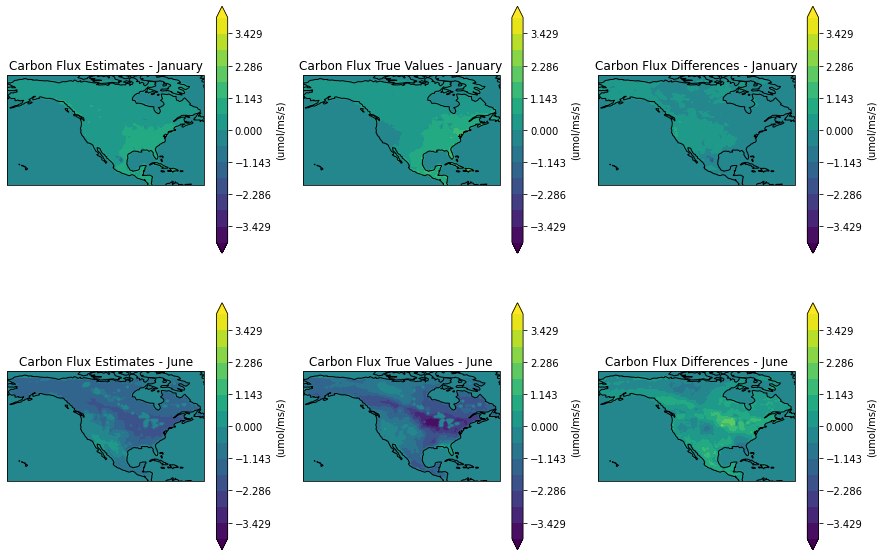

In [34]:
fig, ((ax1, ax2, ax3), 
      (ax4, ax5, ax6)) = plt.subplots( 2,3, 
            subplot_kw={'projection': ccrs.PlateCarree()}, figsize=(15,10))

a = np.reshape(np.ravel(y_est, order='F'), (2613,12,1,-1),order='F') 
realvals = np.reshape(np.ravel(scaler_y_test.inverse_transform(y_test), order='F'), (2613,12,1,-1),order='F') 
levels = np.linspace(-4, 4, 15)


xi, yi, zi_flux = data2grid(lats,lons,a[:,1])
a1=ax1.contourf(xi, yi, zi_flux, 60,levels=levels,
             transform=ccrs.PlateCarree(),extend='both')

cbr=fig.colorbar(a1,ax=ax1)
cbr.set_label('(umol/ms/s)')
ax1.coastlines()
ax1.set(title=('Carbon Flux Estimates - January'))
        
        
xi, yi, zi_flux = data2grid(lats,lons,realvals[:,1])
a2=ax2.contourf(xi, yi, zi_flux, 60,levels=levels,
             transform=ccrs.PlateCarree(),extend='both')

cbr=fig.colorbar(a2,ax=ax2)
cbr.set_label('(umol/ms/s)')
ax2.coastlines()
ax2.set(title=('Carbon Flux True Values - January'))
        
diffs = a-realvals

xi, yi, zi_flux = data2grid(lats,lons,diffs[:, 1]) 
a3=ax3.contourf(xi, yi, zi_flux, 60,levels=levels,
    transform=ccrs.PlateCarree(),extend='both')


cbr=fig.colorbar(a3,ax=ax3)
cbr.set_label('(umol/ms/s)')
ax3.coastlines()
ax3.set(title=('Carbon Flux Differences - January'))




xi, yi, zi_flux = data2grid(lats,lons,a[:,6])
a4=ax4.contourf(xi, yi, zi_flux, 60,levels=levels,
             transform=ccrs.PlateCarree(),extend='both')


cbr=fig.colorbar(a4,ax=ax4)
cbr.set_label('(umol/ms/s)')
ax4.coastlines()
ax4.set(title=('Carbon Flux Estimates - June'))
        
        
xi, yi, zi_flux = data2grid(lats,lons,realvals[:,6])
a5=ax5.contourf(xi, yi, zi_flux, 60,levels=levels,
             transform=ccrs.PlateCarree(),extend='both')


cbr=fig.colorbar(a5,ax=ax5)
cbr.set_label('(umol/ms/s)')
ax5.coastlines()
ax5.set(title=('Carbon Flux True Values - June'))
        
diffs = a-realvals

xi, yi, zi_flux = data2grid(lats,lons,diffs[:, 6]) 
a6=ax6.contourf(xi, yi, zi_flux, 60,levels=levels,
    transform=ccrs.PlateCarree(),extend='both')


cbr=fig.colorbar(a6,ax=ax6)
cbr.set_label('(umol/ms/s)')
ax6.coastlines()
ax6.set(title=('Carbon Flux Differences - June'))

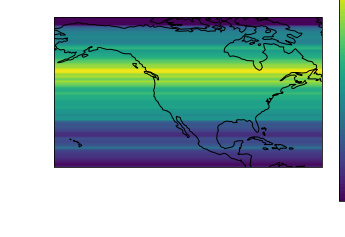

In [35]:
flux = nc_inv.variables['monthly_flux'][0, :] # note shape of flux is [space dimension x time dimension]

# save lat lon from **MODIS** variable ****<<<<<IMPORTANT>>>>>******
lats = nc_modis.variables['lat'][:]
lons = nc_modis.variables['lon'][:]

xi, yi, zi_flux = data2grid(lats,lons,flux) # regrid for plotting

for i in range(len(zi_flux)):
    zi_flux[i]=np.mean(zi_flux[i])
# projection axis
ax = plt.axes(projection=ccrs.PlateCarree())


# plot contour of variable using gridded  lat, lon, and variable
plt.contourf(xi, yi, zi_flux, 60,
             transform=ccrs.PlateCarree())
# add coasts
ax.coastlines()


plt.colorbar()
plt.show()
